<a href="https://colab.research.google.com/github/Howida100/deep-learning-/blob/master/FEATURE_SELECTION_(dynamic_dataset).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
# Univariate Selection
#https://towardsdatascience.com/feature-selection-techniques-in-machine-learning-with-python-f24e7da3f36e
#SelectKBest

import pandas as pd
import numpy as np
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

In [0]:
import matplotlib.pyplot as plt
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [0]:
from google.colab import files

uploaded = files.upload()

Saving complete combined.csv to complete combined.csv


In [0]:
for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

User uploaded file "complete combined.csv" with length 11408868 bytes


In [0]:
#Reading data from CSV file
import pandas as pd
import numpy as np
df = pd.read_csv('complete combined.csv')
df

,Package,Category,Default : Access DRM content. (S),Default : Access Email provider data (S),Default : Access all system downloads (S),Default : Access download manager. (S),Default : Advanced download manager functions. (S),Default : Audio File Access (S),Default : Install DRM content. (S),Default : Modify Google service configuration (S),...,Your personal information : read calendar events (D),Your personal information : read contact data (D),Your personal information : read sensitive log data (D),Your personal information : read user defined dictionary (D),Your personal information : retrieve system internal state (S),Your personal information : set alarm in alarm clock (S),Your personal information : write Browser's history and bookmarks (D),Your personal information : write contact data (D),Your personal information : write to user defined dictionary (S),lablel
0,net.iconchanger,Personalization,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
1,com.Jaaru.TruthorDareFree,Comics,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
2,com.jrtstudio.iSyncr,Music & Audio,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
3,com.ftbsports.fmrm,Sports Games,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
4,com.sillycube.android.Rushing,Sports Games,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
5,com.mathpad.mobile.android.wt.unit,Tools,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
6,com.tvshowfavs,Entertainment,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
7,com.AndPhone.game.DonutKungFu,Racing,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
8,com.highlycaffeinatedcode.scrabblehelper,Brain & Puzzle,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
9,com.doenter.android.vpn.fivevpn,Tools,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware


In [0]:
df 


,Package,Category,Default : Access DRM content. (S),Default : Access Email provider data (S),Default : Access all system downloads (S),Default : Access download manager. (S),Default : Advanced download manager functions. (S),Default : Audio File Access (S),Default : Install DRM content. (S),Default : Modify Google service configuration (S),...,Your personal information : read calendar events (D),Your personal information : read contact data (D),Your personal information : read sensitive log data (D),Your personal information : read user defined dictionary (D),Your personal information : retrieve system internal state (S),Your personal information : set alarm in alarm clock (S),Your personal information : write Browser's history and bookmarks (D),Your personal information : write contact data (D),Your personal information : write to user defined dictionary (S),lablel
0,net.iconchanger,Personalization,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
1,com.Jaaru.TruthorDareFree,Comics,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
2,com.jrtstudio.iSyncr,Music & Audio,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
3,com.ftbsports.fmrm,Sports Games,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
4,com.sillycube.android.Rushing,Sports Games,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
5,com.mathpad.mobile.android.wt.unit,Tools,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
6,com.tvshowfavs,Entertainment,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
7,com.AndPhone.game.DonutKungFu,Racing,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
8,com.highlycaffeinatedcode.scrabblehelper,Brain & Puzzle,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
9,com.doenter.android.vpn.fivevpn,Tools,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware


In [0]:
df 


,Package,Default : Access DRM content. (S),Default : Access Email provider data (S),Default : Access all system downloads (S),Default : Access download manager. (S),Default : Advanced download manager functions. (S),Default : Audio File Access (S),Default : Install DRM content. (S),Default : Modify Google service configuration (S),Default : Modify Google settings (S),...,Your personal information : read calendar events (D),Your personal information : read contact data (D),Your personal information : read sensitive log data (D),Your personal information : read user defined dictionary (D),Your personal information : retrieve system internal state (S),Your personal information : set alarm in alarm clock (S),Your personal information : write Browser's history and bookmarks (D),Your personal information : write contact data (D),Your personal information : write to user defined dictionary (S),lablel
0,net.iconchanger,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
1,com.Jaaru.TruthorDareFree,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
2,com.jrtstudio.iSyncr,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
3,com.ftbsports.fmrm,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
4,com.sillycube.android.Rushing,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
5,com.mathpad.mobile.android.wt.unit,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
6,com.tvshowfavs,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
7,com.AndPhone.game.DonutKungFu,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
8,com.highlycaffeinatedcode.scrabblehelper,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware
9,com.doenter.android.vpn.fivevpn,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,malware


In [0]:
X = df.iloc[:,1:174]  #independent columns
y = df.iloc[:,174]    #target column i.e label(malware or not)

In [0]:
#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=100)
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)
#concat two dataframes for better visualization 
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['features ','Score']  #naming the dataframe columns
print(featureScores.nlargest(120,'Score'))  #print 100 best features


                                             features         Score
60                    Default : write contact data (S)  5425.572557
52         Default : read phone state and identity (S)  4367.868890
46   Default : permission to install a location pro...  2676.314167
22   Default : control location update notification...  2670.025526
99          System tools : format external storage (D)  2410.261916
137  Your accounts : contacts data in Google accoun...  2346.573260
16   Default : access to passwords for Google accou...  2280.966937
153                Your messages : read SMS or MMS (D)  2264.566426
5                      Default : Audio File Access (S)  2173.940923
156                    Your messages : receive SMS (D)  1765.811859
133     Your accounts : access all Google services (S)  1315.442355
161  Your personal information : add or modify cale...  1231.228034
69                Hardware controls : record audio (D)  1131.235868
171  Your personal information : write contact d

/usr/local/lib/python3.6/dist-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


[3.19917042e-04 2.98418853e-04 1.42683202e-03 1.07216981e-05
 0.00000000e+00 3.81869713e-02 3.72814612e-05 2.03141807e-07
 1.69919345e-03 1.74103409e-04 7.12644945e-06 1.09271989e-04
 4.61224240e-05 9.41683107e-05 1.36996371e-05 3.14451785e-03
 3.11484427e-02 0.00000000e+00 3.41062330e-05 3.86005063e-04
 4.60807841e-04 0.00000000e+00 5.78823818e-02 6.52080162e-05
 1.06671122e-04 1.39903562e-04 2.61685135e-04 4.08814951e-04
 5.77712323e-04 4.76359926e-04 9.22545350e-03 2.90445180e-05
 1.14092455e-02 1.87239961e-07 1.12202997e-02 4.21367382e-04
 9.14541210e-03 0.00000000e+00 0.00000000e+00 1.64853837e-02
 5.90266485e-04 1.95046087e-02 0.00000000e+00 8.20487156e-07
 1.53741413e-07 0.00000000e+00 1.26629447e-03 7.08192232e-04
 1.99732998e-05 1.72932305e-03 8.67089923e-05 1.10986658e-05
 1.12426429e-01 1.60403608e-07 0.00000000e+00 0.00000000e+00
 1.56829065e-05 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.51094640e-01 6.94095778e-06 9.35830290e-05 0.00000000e+00
 9.03420577e-05 0.000000

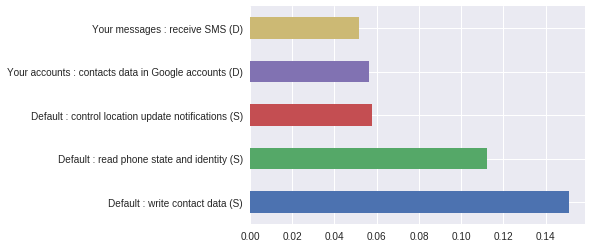

In [0]:
#Feature Importance
X = df.iloc[:,1:174]  #independent columns
y = df.iloc[:,174]    #target column i.e label(malware or not)
from sklearn.ensemble import ExtraTreesClassifier
import matplotlib.pyplot as plt
model = ExtraTreesClassifier()
model.fit(X,y)
print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers
#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(5).plot(kind='barh')
plt.show()

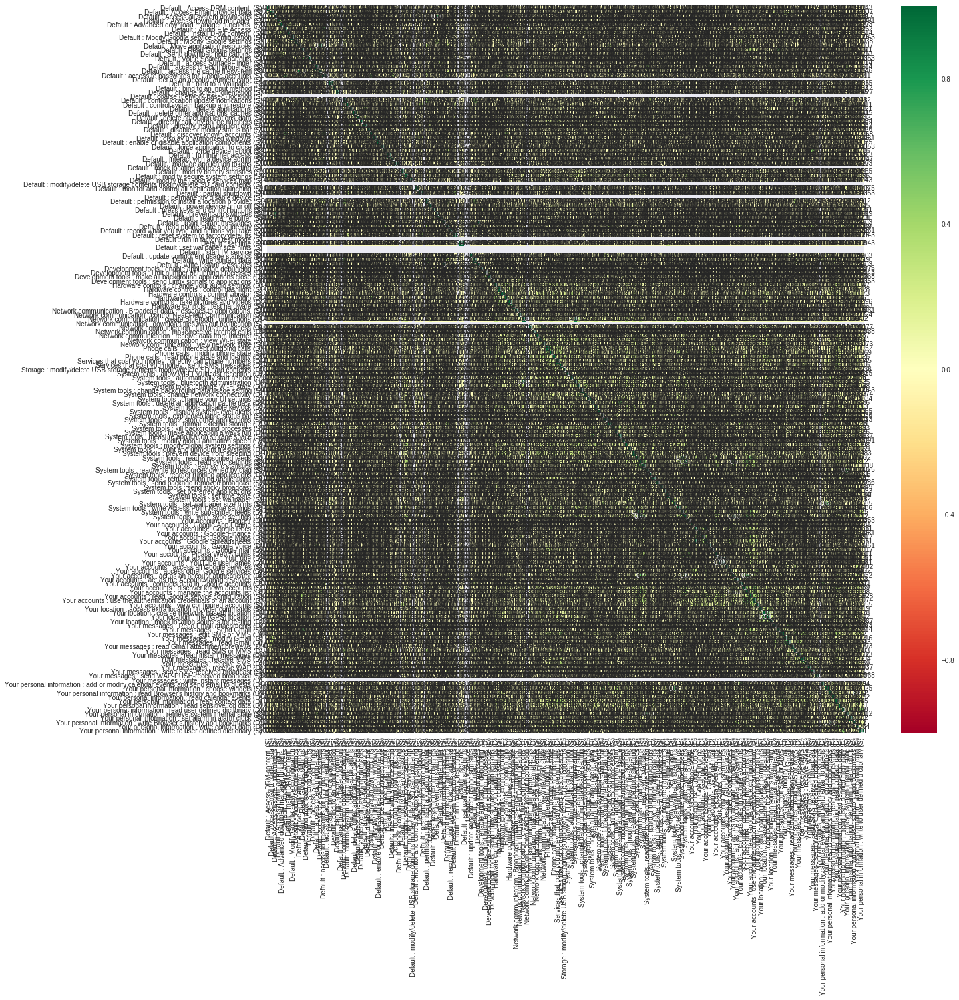

In [0]:
import pandas as pd
import numpy as np
import seaborn as sns
corrmat = df.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(20,20))
#plot heat map
g=sns.heatmap(df[top_corr_features].corr(),annot=True,cmap="RdYlGn")

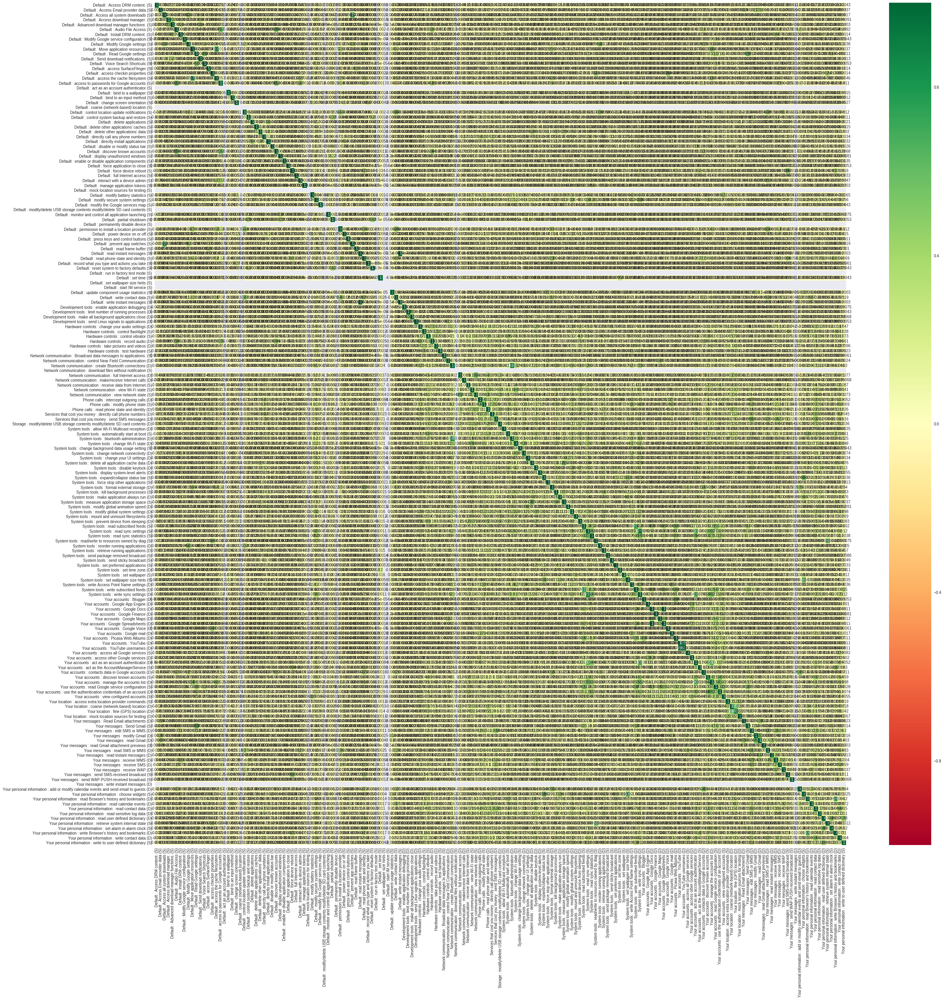

In [0]:
import pandas as pd
import numpy as np
import seaborn as sns
corrmat = df.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(40,40))
#plot heat map
g=sns.heatmap(df[top_corr_features].corr(),annot=True,cmap="RdYlGn")

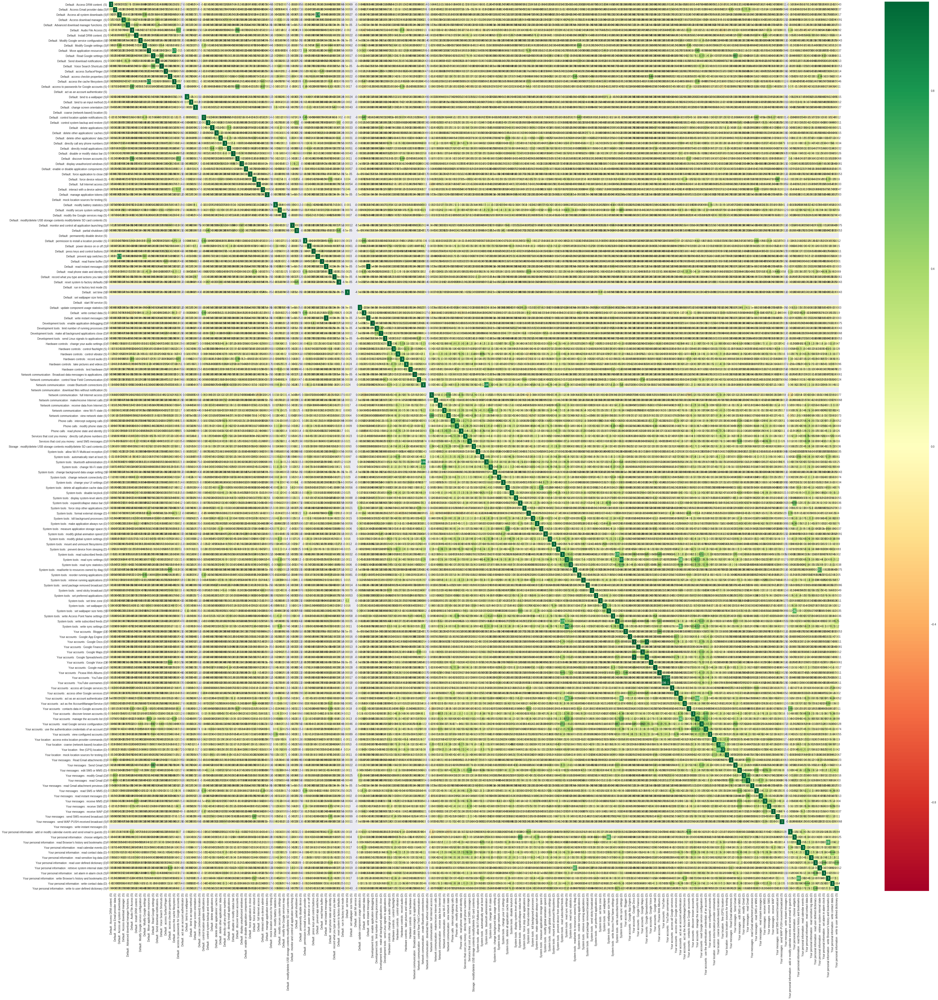

In [0]:
#Correlation can be positive (increase in one value of feature increases the value of the target variable) or negative 
#(increase in one value of feature decreases the value of the target variable)
import pandas as pd
import numpy as np
import seaborn as sns
corrmat = df.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(60,60))
#plot heat map
g=sns.heatmap(df[top_corr_features].corr(),annot=True,cmap="RdYlGn")